In [1]:
from pygradu import shortest_path
from pygradu import gridify

import shapely.geometry
import pandas as pd
import numpy as np
import importlib

importlib.reload(gridify)

grid_2500m = gridify.area_to_grid(side_length=2500)
grid_5km = gridify.area_to_grid(side_length=5000)

MODELS_DIR = 'data/models/'
DATASET_DIR = 'data/datasets/'

graph_df_adj_2500m = pd.read_csv(MODELS_DIR + 'complete_graph_adjacent_2500m.csv')[['original', 'connected', 'cost']]
graph_df_ship_2500m = pd.read_csv(MODELS_DIR + 'complete_graph_ship_model_2500m.csv')[['original', 'connected', 'cost']]

graph_df_adj_5km = pd.read_csv(MODELS_DIR + 'complete_graph_adjacent_5km.csv')[['original', 'connected', 'cost']]
graph_df_ship_5km = pd.read_csv(MODELS_DIR + 'complete_graph_ship_model_5km.csv')[['original', 'connected', 'cost']]

graph_df_adj_5km.head()

Original NE: POINT (31.5 66.8)
Original SW: POINT (8.5 53)
Transformed NE: (697681.2863658136, 7416224.9393330095)
Transformed SW: (-735260.4063631196, 6033964.466017238)
col_count 573
row_count 552
grid_size 316296
Original NE: POINT (31.5 66.8)
Original SW: POINT (8.5 53)
Transformed NE: (697681.2863658136, 7416224.9393330095)
Transformed SW: (-735260.4063631196, 6033964.466017238)
col_count 286
row_count 276
grid_size 78936


,original,connected,cost
0,350,351,1.0
1,350,625,1.0
2,350,626,1.0
3,350,627,1.0
4,351,350,1.0


In [2]:
importlib.reload(shortest_path)

%time graph_adj_2500m = shortest_path.df_to_graph(graph_df_adj_2500m)
%time graph_ship_2500m = shortest_path.df_to_graph(graph_df_ship_2500m)

%time graph_adj_5km = shortest_path.df_to_graph(graph_df_adj_5km)
%time graph_ship_5km = shortest_path.df_to_graph(graph_df_ship_5km)

CPU times: user 1.83 s, sys: 107 ms, total: 1.94 s
Wall time: 1.55 s
CPU times: user 10.9 s, sys: 560 ms, total: 11.5 s
Wall time: 11.4 s
CPU times: user 265 ms, sys: 14.5 ms, total: 279 ms
Wall time: 294 ms
CPU times: user 2.15 s, sys: 99.8 ms, total: 2.25 s
Wall time: 1.82 s


In [3]:
# Convert speed model to dict

speed_model_2500m = pd.read_csv(MODELS_DIR + 'speed_model_2500m.csv', index_col=0).to_dict()
speed_model_2500m = {int(k):v for k,v in speed_model_2500m.items()}

speed_model_5km = pd.read_csv(MODELS_DIR + 'speed_model_5km.csv', index_col=0).to_dict()
speed_model_5km = {int(k):v for k,v in speed_model_5km.items()}
speed_model_5km[354]

{'CONT': nan,
 'GC': 4.114166666666667,
 'PAS': 4.644285714285715,
 'RORO': nan,
 'T': nan}

In [5]:
# Load test set
test_voyages = pd.read_csv(DATASET_DIR + 'validation_set_winter.csv', index_col=0, parse_dates = ['timestamp', 'ata', 'atd'])
test_voyages.head()

,timestamp,mmsi,lat,lon,speed,node,vessel_type,iceclass,start_port,end_port,end_lat,end_lon,ata,atd,in_port,voyage,course,end_port_sea_area
1229,2019-03-20 14:38:32,209185000,61.622468,17.207792,4.78,11387,GC,IA,3012222,935,65.234498,21.628285,2019-03-22 00:08:31,2019-03-20 14:38:32,False,5,-1,1
1230,2019-03-20 14:44:01,209185000,61.622263,17.241178,5.61,11387,GC,IA,3012222,935,65.234498,21.628285,2019-03-22 00:08:31,2019-03-20 14:38:32,False,5,-1,1
1231,2019-03-20 14:49:25,209185000,61.622037,17.275425,5.45,11387,GC,IA,3012222,935,65.234498,21.628285,2019-03-22 00:08:31,2019-03-20 14:38:32,False,5,-1,1
1232,2019-03-20 14:54:42,209185000,61.615038,17.299898,3.96,11387,GC,IA,3012222,935,65.234498,21.628285,2019-03-22 00:08:31,2019-03-20 14:38:32,False,5,-1,1
1233,2019-03-20 14:59:52,209185000,61.609090,17.316947,3.96,11387,GC,IA,3012222,935,65.234498,21.628285,2019-03-22 00:08:31,2019-03-20 14:38:32,False,5,-1,1


In [7]:
# Load dirways

dirways = pd.read_csv(DATASET_DIR + 'dirways_all_2018_2019.csv', parse_dates = ['publishtime', 'deletetime', 'createtime'])
test_dirways = dirways[(dirways.publishtime < '2019-02-10 12:08:06') & (dirways.deletetime > '2019-02-10 12:08:06')]
print(len(test_dirways))
test_dirways.head()

23


,id,name,number,lat,lon,dp_id,dp_src,publishtime,deletetime,createtime
183,16_31000017,OTSO 0125 Oul,2,64.866667,24.166667,31000060,16,2019-01-25 08:42:59.739695,2019-02-11 09:28:23.087837300,2019-01-25 08:20:02.524413600
184,16_31000016,OTSO 0125 Raa,0,64.050000,22.500000,31000066,16,2019-01-25 08:43:03.662890,2019-02-11 09:28:18.625639000,2019-01-25 08:24:42.545218400
185,16_31000016,OTSO 0125 Raa,1,64.658432,23.733333,31000067,16,2019-01-25 08:43:03.662890,2019-02-11 09:28:18.625639000,2019-01-25 08:24:42.560843400
186,16_31000016,OTSO 0125 Raa,2,64.666667,23.900000,31000068,16,2019-01-25 08:43:03.662890,2019-02-11 09:28:18.625639000,2019-01-25 08:24:42.560843400
187,16_31000017,OTSO 0125 Oul,0,64.050000,22.500000,31000073,16,2019-01-25 08:42:59.739695,2019-02-11 09:28:23.087837300,2019-01-25 08:32:30.194689500


#### Visualise observations with active dirways in a point in time

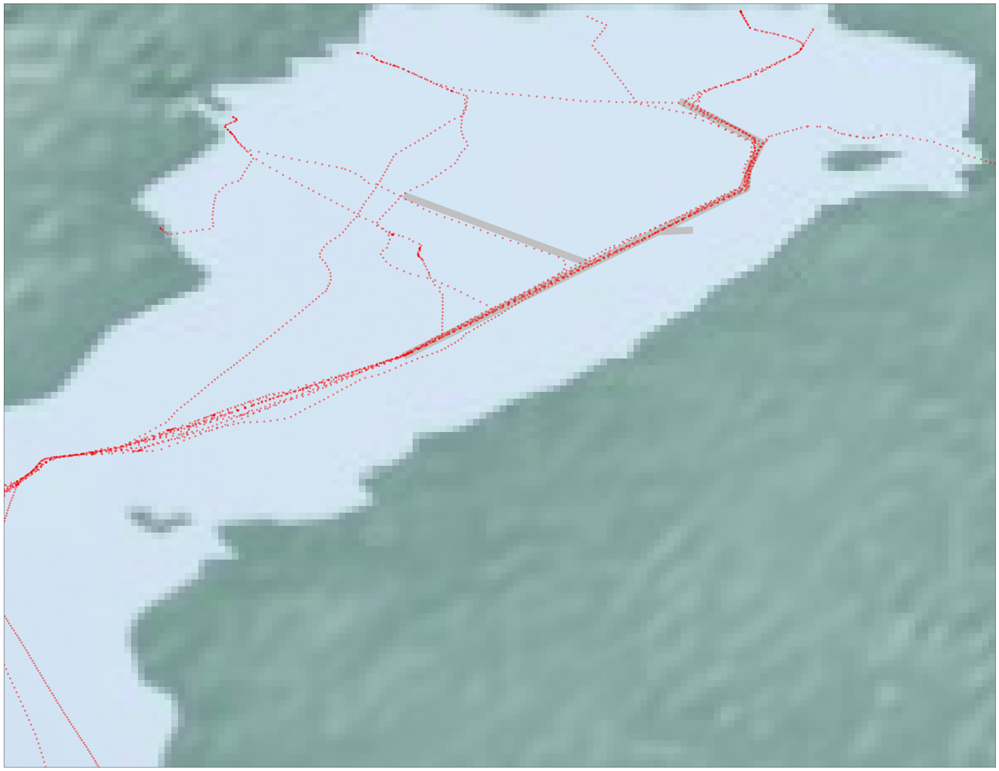

In [8]:
import matplotlib.pyplot as plt
%matplotlib inline 
from mpl_toolkits.basemap import Basemap

test_voyages_north = test_voyages[(test_voyages.lat > 62) & (test_voyages.lon > 20.5)]

fig = plt.figure(figsize=(50,50))
m = Basemap(llcrnrlon = test_voyages_north.lon.min(),llcrnrlat = test_voyages_north.lat.min(), urcrnrlon = test_voyages_north.lon.max(),
       urcrnrlat = test_voyages_north.lat.max(),
       resolution='l')
m.shadedrelief()

g_dws = test_dirways.groupby('id')

for i, dw in g_dws:
    dw = dw.sort_values(by=['number'])
    dw = dw.reset_index(drop=True)
    xy = dw.loc[:, ('lat', 'lon')]
    #print(xy)
    plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='silver', alpha=1, markersize=20, linewidth=20, label="Dirway")
    
obs = test_voyages_north[(test_voyages_north.timestamp > test_dirways.publishtime.min()) & (test_voyages_north.timestamp < test_dirways.deletetime.min())]

xy = obs.loc[:, ('lat', 'lon')]
plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 'o', c='red', alpha=0.4, markersize=5)

In [10]:
# Load shallow water

shallow_graph_2500m = set(pd.read_csv(MODELS_DIR + 'shallow_water_model_2500m.csv', index_col=0).original.values)
shallow_graph_5km = set(pd.read_csv(MODELS_DIR + 'shallow_water_model_5km.csv', index_col=0).original.values)

#### Functions for debugging and visualizing the prediction results

In [11]:
import matplotlib.pyplot as plt
from matplotlib import pyplot
%matplotlib inline 
from mpl_toolkits.basemap import Basemap  # import Basemap matplotlib toolkit
import pyproj
from shapely.geometry import Polygon

plt.rcParams.update({'font.size': 45})

def plot_route_and_search_area(routes, areas, test_voyages, dirways, title, use_start_time=True):
    routes_groupped = routes.groupby('voyage')
    for voyage, route in routes_groupped:
        fig, ax = plt.subplots(figsize=(50,50))
        fig_title = title + str(voyage)
        plt.title(fig_title)
        
                
        real_route = test_voyages[(test_voyages.voyage == voyage)]
        
        m = Basemap(llcrnrlon = test_voyages.lon.min(),llcrnrlat = test_voyages.lat.min(), urcrnrlon = test_voyages.lon.max(),
               urcrnrlat = test_voyages.lat.max(),
               resolution='l')
        m.shadedrelief()
        x_y_curve1 = route.loc[:, ('lon', 'lat')].values
        x_y_curve2 = test_voyages[(test_voyages.voyage == voyage)].loc[:, ('lon', 'lat')].values #these are your points for curve 2 (I just put some random numbers)

        polygon_points = [] #creates a empty list where we will append the points to create the polygon

        for xyvalue in x_y_curve1:
            polygon_points.append([xyvalue[0],xyvalue[1]]) #append all xy points for curve 1

        for xyvalue in x_y_curve2[::-1]:
            polygon_points.append([xyvalue[0],xyvalue[1]]) #append all xy points for curve 2 in the reverse order (from last point to first point)

        for xyvalue in x_y_curve1[0:1]:
            polygon_points.append([xyvalue[0],xyvalue[1]]) #append the first point in curve 1 again, to it "closes" the polygon

        polygon = Polygon(polygon_points)
        ax.fill(*polygon.exterior.xy, label="Difference area")
        
        ata = test_voyages[test_voyages.voyage == voyage].iloc[0].ata
        
        test_dirways = dirways[(dirways.publishtime < ata) & (dirways.deletetime > ata)]
        g_dws = test_dirways.groupby('id')
        for i, dw in g_dws:
            dw = dw.sort_values(by=['number'])
            dw = dw.reset_index(drop=True)
            xy = dw.loc[:, ('lat', 'lon')]
            plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='darkgrey', alpha=1, label='Dirway', markersize=20, linewidth=20)
            
                
        xy = areas[areas.voyage == voyage].loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 'o', c='orange', alpha=1, markersize=4, label='Search Area')
        
        if use_start_time:
            xy = test_voyages[(test_voyages.timestamp >= start_time) & (test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
        else:
            xy = test_voyages[(test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='firebrick', alpha=1, markersize=7, linewidth=7, label='Actual')
        
        xy = route.loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='darkturquoise', alpha=1, markersize=7, linewidth=7, label='Predicted')
        
        
        handles, labels = plt.gca().get_legend_handles_labels()
        newLabels, newHandles = [], []
        for handle, label in zip(handles, labels):
          if label not in newLabels:
            newLabels.append(label)
            newHandles.append(handle)
        plt.legend(newHandles, newLabels)
        plt.savefig('pictures/' + fig_title.replace(':', '') + '.png', bbox_inches = 'tight',
        pad_inches = 0)
        plt.show()
        
def plot_predicted_and_actual_route(routes, test_voyages):
    routes_groupped = routes.groupby('voyage')
    for voyage, route in routes_groupped:
        fig = plt.figure(figsize=(60,60))
        m = Basemap(llcrnrlon = test_voyages.lon.min(),llcrnrlat = test_voyages.lat.min(), urcrnrlon = test_voyages.lon.max(),
               urcrnrlat = test_voyages.lat.max(),
               resolution='l')
        m.shadedrelief()
        
        start_time = route.head(1).iloc[0].start_time
        
        xy = route.loc[:, ('lat', 'lon')]

        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='black', alpha=1, markersize=5, linewidth=5)
        
        xy = test_voyages[(test_voyages.timestamp >= start_time) & (test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='darkorange', alpha=1, dashes=[4, 2], markersize=5, linewidth=5)
        plt.show()
        
        
def plot_route(data):
    fig = plt.figure(figsize=(50,50))
    m = Basemap(llcrnrlon = test_voyages.lon.min(),llcrnrlat = test_voyages.lat.min(), urcrnrlon = test_voyages.lon.max(),
           urcrnrlat = test_voyages.lat.max(),
           resolution='l')
    m.shadedrelief()
    
    xy = data.loc[:, ('pred_lat', 'pred_lon')]
    plt.plot(xy.loc[:, ('pred_lon')], xy.loc[:, ('pred_lat')], 'o', c='black', alpha=1, markersize=5)

    xy = data.loc[:, ('actual_lat', 'actual_lon')]
    plt.plot(xy.loc[:, ('actual_lon')], xy.loc[:, ('actual_lat')], 'o', c='darkorange', alpha=1, markersize=2.5)


In [12]:
# Get long voyages from near danmark all the way to the northern Bay of Bothnia
long = set(test_voyages[(test_voyages.end_lat > 60)].voyage.drop_duplicates().values)
long_voyages = test_voyages[test_voyages.voyage.isin(long)]
long_voyages['course'] = -1
#print(long_voyages.head(1))
voyages = test_voyages.groupby('voyage')
first_rows = []
for voyage, observations in voyages:
    if len(observations) is 1:
        continue
    course = shortest_path.angleFromCoordinatesInDeg([observations.iloc[0].lat, observations.iloc[0].lon], [observations.iloc[1].lat, observations.iloc[1].lon])
    row = observations.iloc[1]
    row.course = course
    first_rows.append(row)

test = pd.DataFrame(data=first_rows, columns=long_voyages.columns)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/anaconda3/lib/python3.7/site-packages/pandas/core/generic.py:4405: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


,timestamp,mmsi,lat,lon,speed,node,vessel_type,iceclass,start_port,end_port,end_lat,end_lon,ata,atd,in_port,voyage,course,end_port_sea_area
1230,2019-03-20 14:44:01,209185000,61.622263,17.241178,5.61,11387,GC,IA,3012222,935,65.234498,21.628285,2019-03-22 00:08:31,2019-03-20 14:38:32,False,5,90.725478,1
3041,2019-02-09 01:52:51,209467000,65.222573,21.647583,2.11,16519,CONT,IA,935,6652,54.365267,10.144437,2019-02-11 15:49:55,2019-02-09 01:47:32,False,15,143.856736,-1
3647,2019-02-23 00:34:33,209467000,65.210282,21.631402,5.86,16519,CONT,IA,935,6652,54.374755,10.177130,2019-02-25 15:30:35,2019-02-23 00:28:32,False,16,141.574254,-1
5762,2019-03-22 21:31:43,209467000,65.209857,21.651402,4.22,16519,CONT,IA,935,30775,59.162025,17.663345,2019-03-24 08:55:07,2019-03-22 21:26:10,False,21,176.249323,6
13242,2019-02-01 21:59:31,212018000,65.219908,21.651478,4.06,16519,CONT,IA,935,6652,54.365450,10.143257,2019-02-04 18:12:41,2019-02-01 21:54:20,False,43,145.443601,-1


In [20]:
visualisation_set = test.sample(3)
visualisation_set.head()

,timestamp,mmsi,lat,lon,speed,node,vessel_type,iceclass,start_port,end_port,end_lat,end_lon,ata,atd,in_port,voyage,course,end_port_sea_area
139378,2019-02-11 11:40:40,245656000,59.0838,17.669033,6.17,7521,RORO,IA,30775,935,65.237900,21.622650,2019-02-12 20:18:54,2019-02-11 11:35:21,False,429,192.272323,1
68793,2019-02-08 05:02:24,230351000,56.1100,12.542915,7.97,3759,GC,IA,8616614,1073,65.754687,24.154367,2019-02-10 16:38:52,2019-02-08 04:57:18,False,208,135.285086,1
61078,2019-03-31 14:40:56,229630000,65.0095,25.374500,5.35,16122,CONT,IA,1027,6652,54.365667,10.144667,2019-04-03 06:32:42,2019-03-31 14:35:45,False,193,304.750421,-1


### Predict routes

In [21]:
# Predicting routes using the adjacent model 5km

importlib.reload(shortest_path)
graph_adj_5km.use_turn_penalty = False
graph_adj_5km.use_shallow_penalty = True
graph_adj_5km.use_dirways = True

%time routes_and_areas = shortest_path.predict_routes(visualisation_set, grid_5km, graph_adj_5km, speed_model_5km, dirways, shallow_graph_5km)
routes_adjacent_5km = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_adjacent_5km = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= True
use_turn_penalty= False
use_shallow_penalty= True
side_length: 5000


/Users/villehak/hobbies/gradu/pygradu/shortest_path.py:391: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  dirways.sort_values(by=['id', 'number'], inplace=True)


Error count= 0
[]
CPU times: user 15.8 s, sys: 186 ms, total: 15.9 s
Wall time: 16.2 s


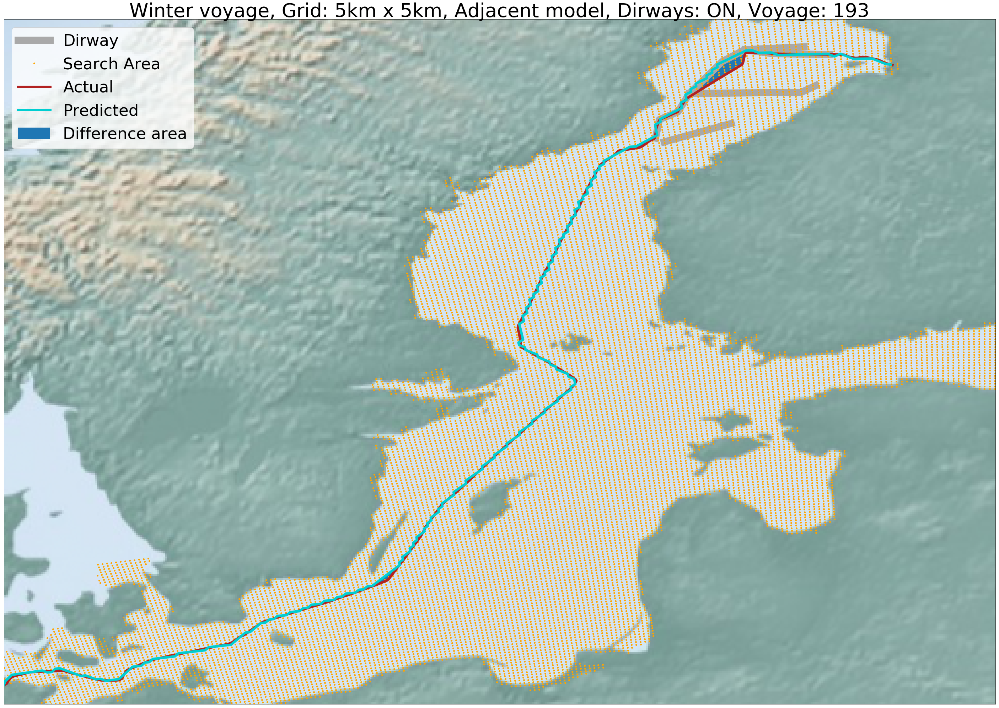

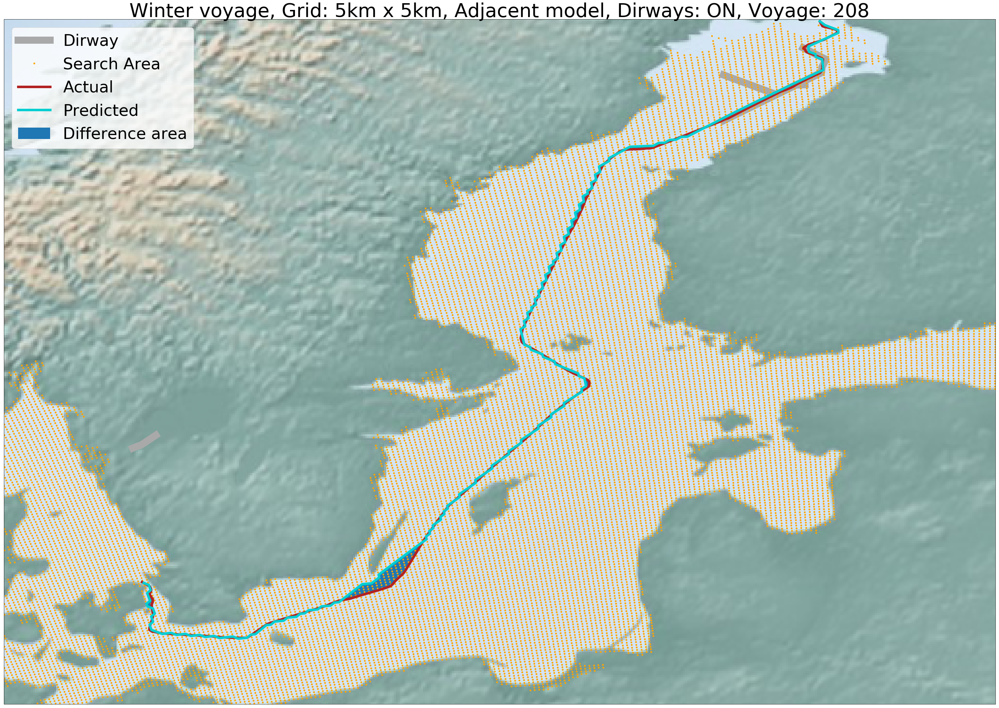

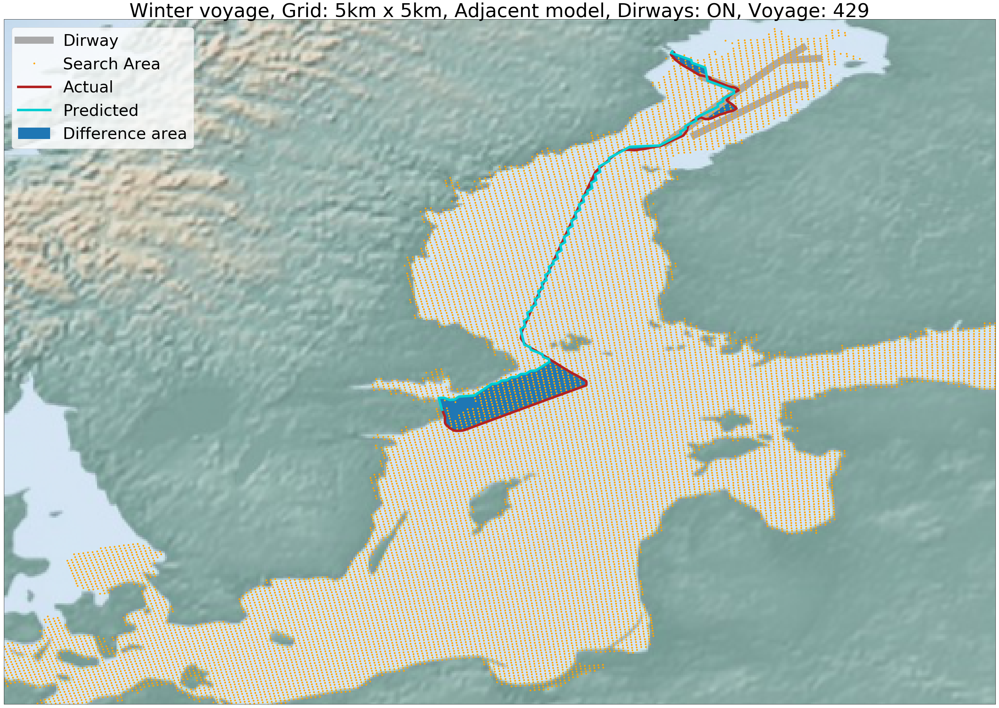

In [22]:
plot_route_and_search_area(routes_adjacent_5km, areas_adjacent_5km, test_voyages, dirways,'Winter voyage, Grid: 5km x 5km, Adjacent model, Dirways: ON, Voyage: ', False)

In [23]:
# Predicting routes using the adjacent model 5km

importlib.reload(shortest_path)
graph_adj_5km.use_turn_penalty = False
graph_adj_5km.use_shallow_penalty = True
graph_adj_5km.use_dirways = False

%time routes_and_areas = shortest_path.predict_routes(visualisation_set, grid_5km, graph_adj_5km, speed_model_5km, dirways, shallow_graph_5km)
routes_adjacent_5km_no_dirways = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_adjacent_5km_no_dirways = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= False
use_turn_penalty= False
use_shallow_penalty= True
side_length: 5000
Error count= 0
[]
CPU times: user 16.4 s, sys: 157 ms, total: 16.6 s
Wall time: 16.8 s


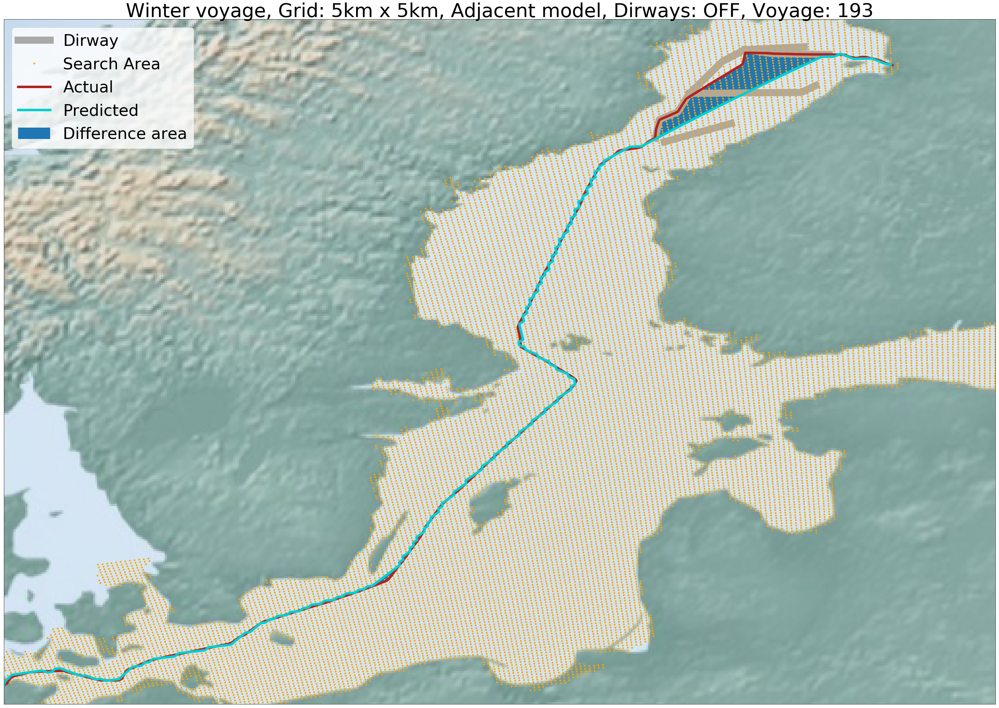

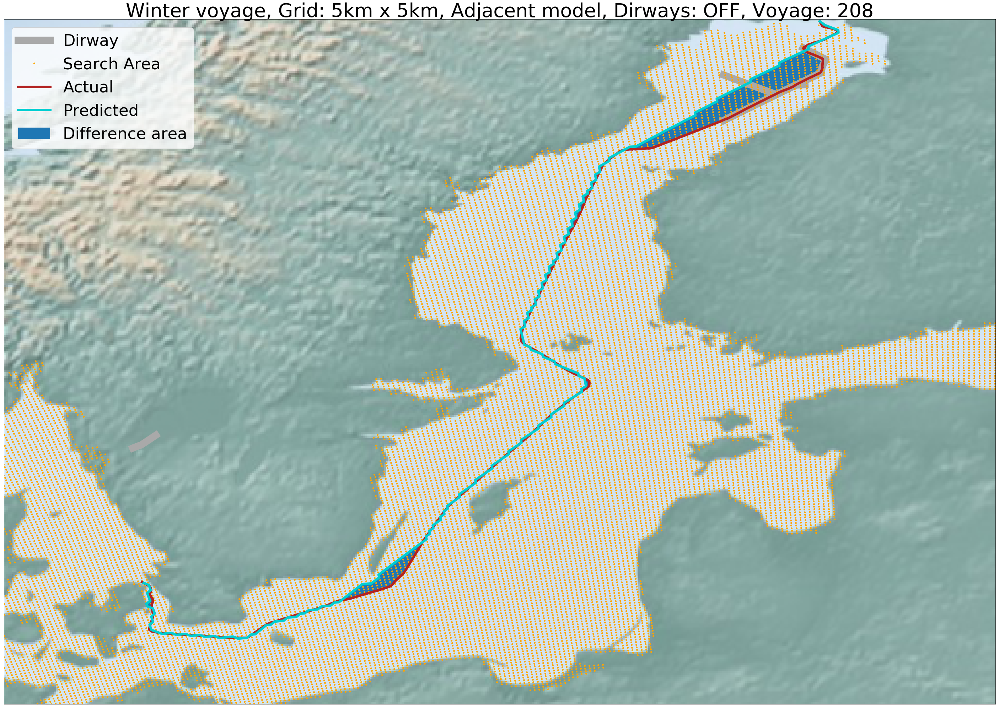

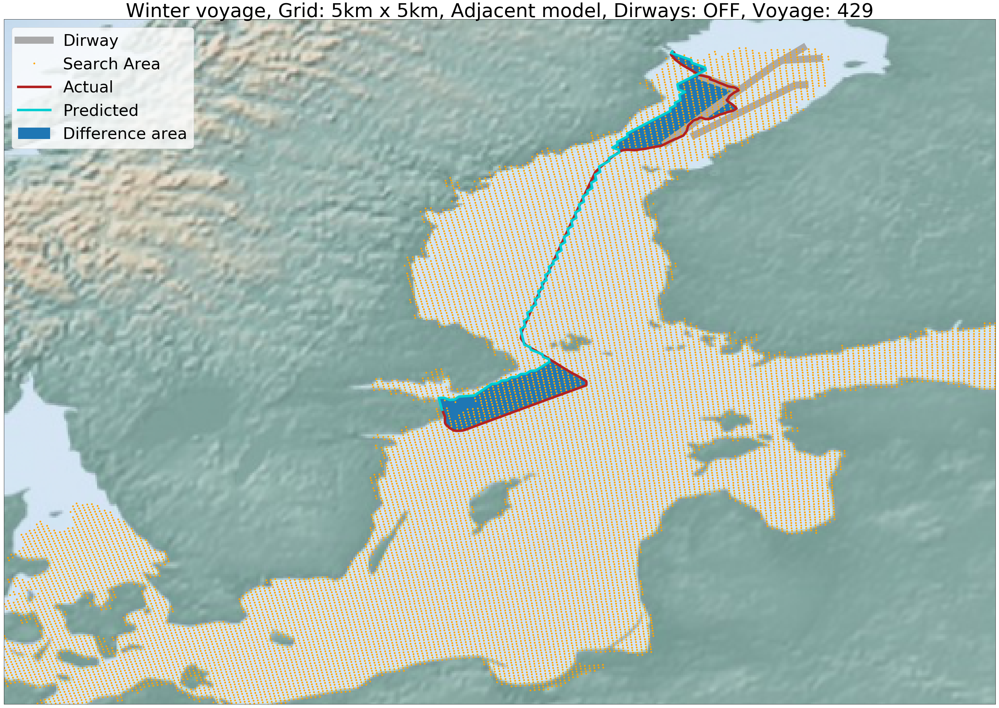

In [24]:
plot_route_and_search_area(routes_adjacent_5km_no_dirways, areas_adjacent_5km_no_dirways, test_voyages, dirways,'Winter voyage, Grid: 5km x 5km, Adjacent model, Dirways: OFF, Voyage: ', False)

In [29]:
# Predicting routes using the ship model 5km

importlib.reload(shortest_path)
graph_ship_5km.use_turn_penalty = False
graph_ship_5km.use_shallow_penalty = True
graph_ship_5km.use_dirways = True

%time routes_and_areas = shortest_path.predict_routes(visualisation_set, grid_5km, graph_ship_5km, speed_model_5km, dirways, shallow_graph_5km)
routes_ship_model_5km = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_ship_model_5km = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= True
use_turn_penalty= False
use_shallow_penalty= True
side_length: 5000


/Users/villehak/hobbies/gradu/pygradu/shortest_path.py:391: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  dirways.sort_values(by=['id', 'number'], inplace=True)


Error count= 0
[]
CPU times: user 2min 50s, sys: 1.14 s, total: 2min 52s
Wall time: 2min 54s


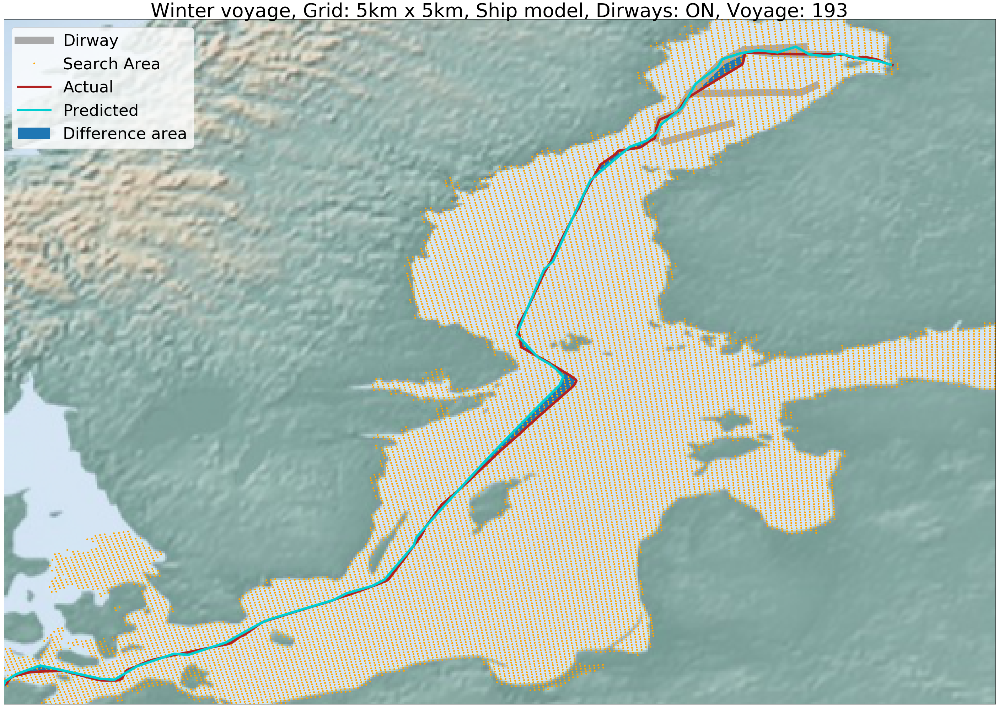

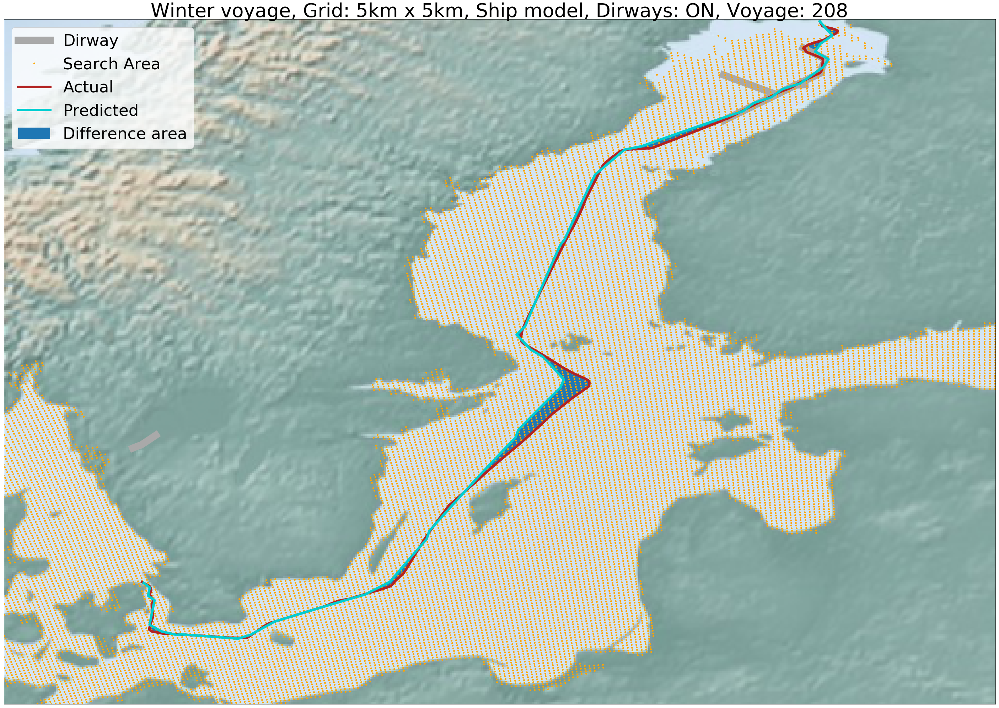

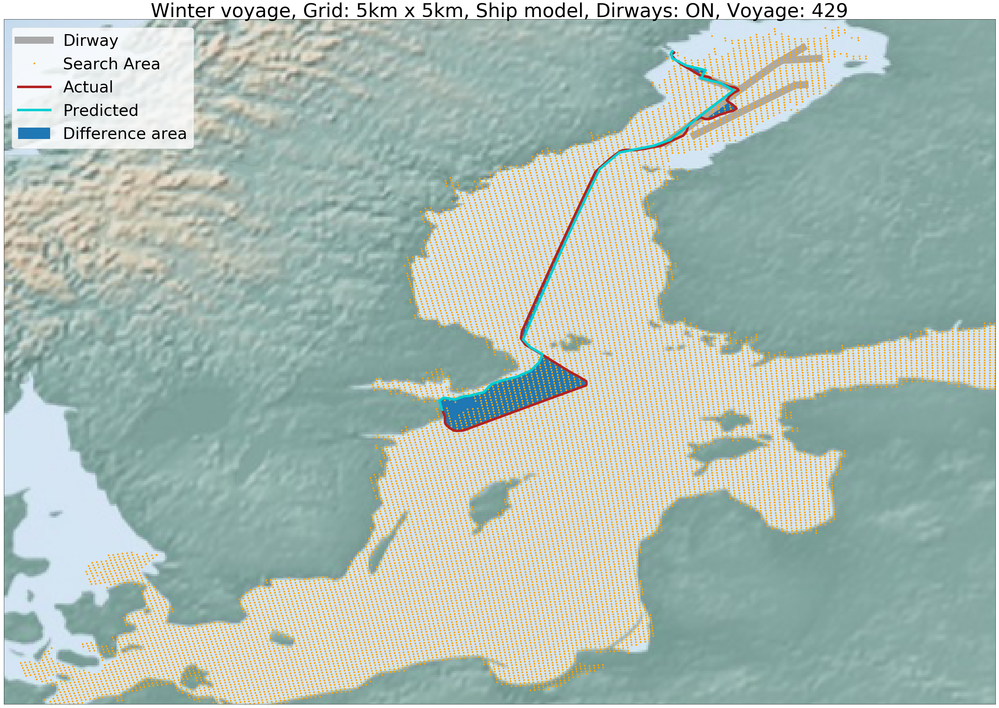

In [30]:
plot_route_and_search_area(routes_ship_model_5km, areas_ship_model_5km, test_voyages, dirways,'Winter voyage, Grid: 5km x 5km, Ship model, Dirways: ON, Voyage: ', False)

In [31]:
# Predicting routes using the ship model 5km

importlib.reload(shortest_path)
graph_ship_5km.use_turn_penalty = False
graph_ship_5km.use_shallow_penalty = True
graph_ship_5km.use_dirways = False

%time routes_and_areas = shortest_path.predict_routes(visualisation_set, grid_5km, graph_ship_5km, speed_model_5km, dirways, shallow_graph_5km)
routes_ship_model_5km_no_dirway = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_ship_model_5km_no_dirway = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= False
use_turn_penalty= False
use_shallow_penalty= True
side_length: 5000
Error count= 0
[]
CPU times: user 2min 38s, sys: 840 ms, total: 2min 39s
Wall time: 2min 41s


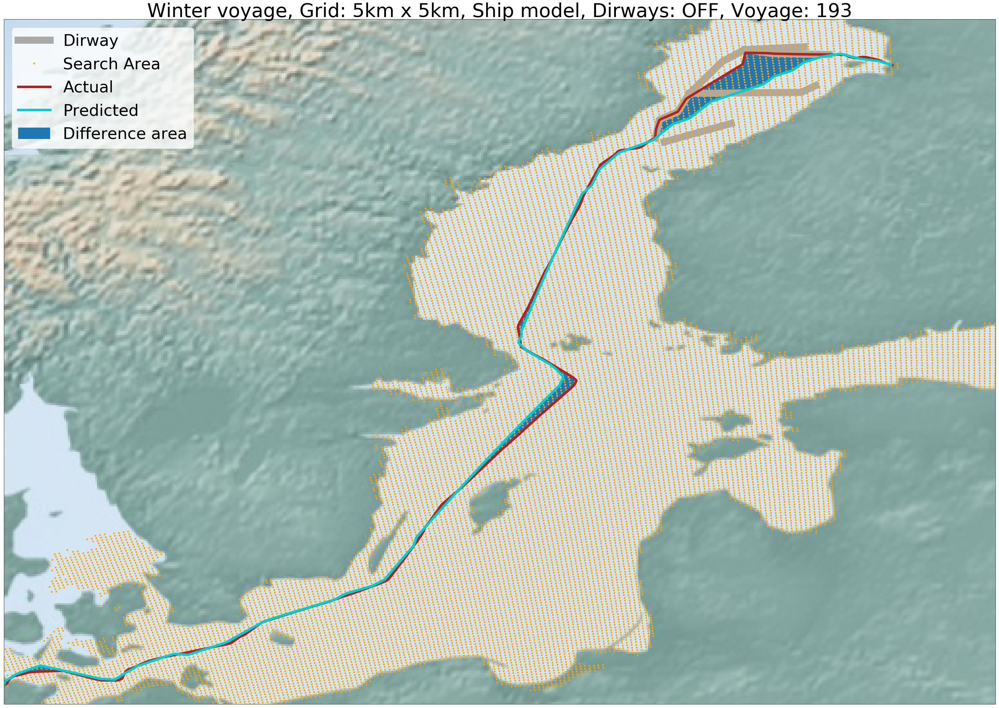

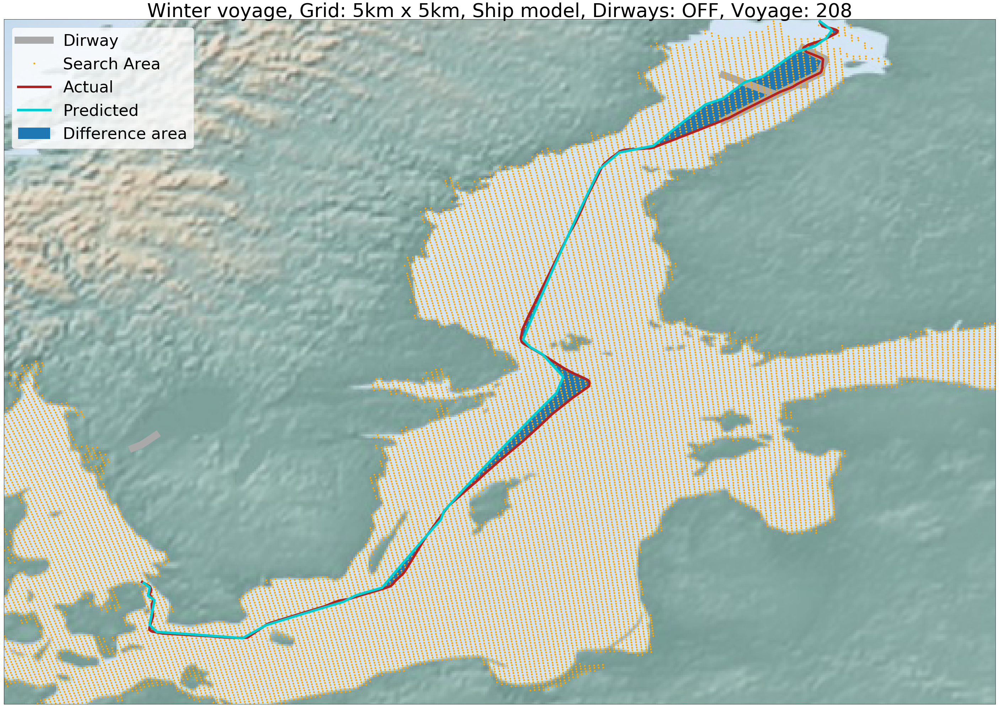

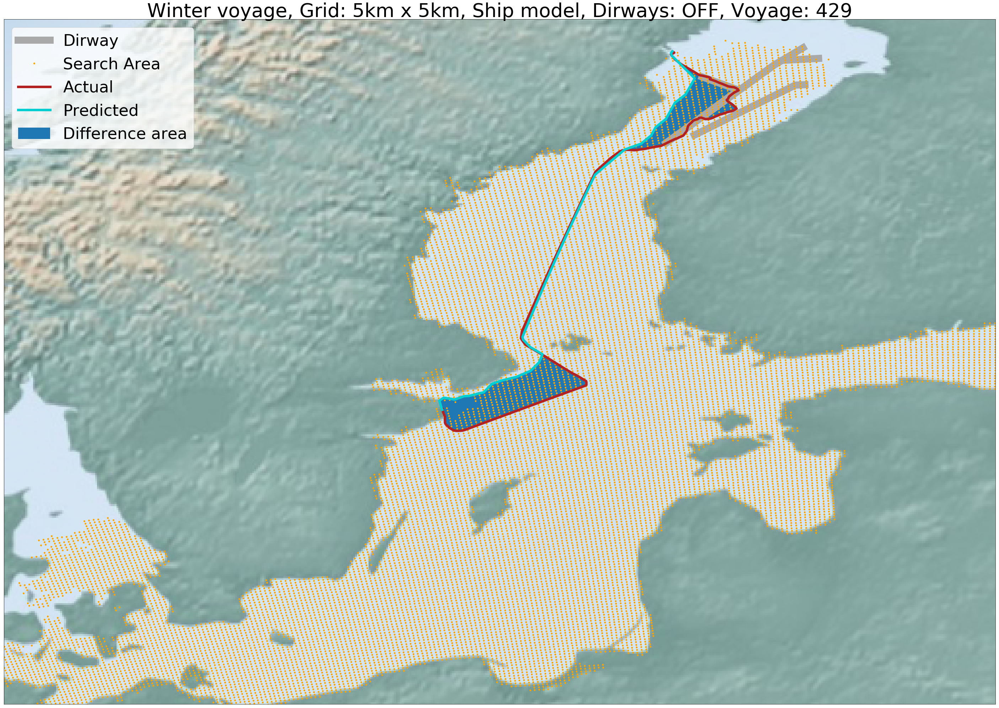

In [32]:
plot_route_and_search_area(routes_ship_model_5km_no_dirway, areas_ship_model_5km_no_dirway, test_voyages, dirways, 'Winter voyage, Grid: 5km x 5km, Ship model, Dirways: OFF, Voyage: ', False)

In [33]:
# Predicting routes using the adjacent model 2500m

importlib.reload(shortest_path)
graph_adj_2500m.use_turn_penalty = False
graph_adj_2500m.use_shallow_penalty = True
graph_adj_2500m.use_dirways = True

%time routes_and_areas = shortest_path.predict_routes(visualisation_set, grid_2500m, graph_adj_2500m, speed_model_2500m, dirways, shallow_graph_2500m)
routes_adjacent_2500m = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_adjacent_2500m = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= True
use_turn_penalty= False
use_shallow_penalty= True
side_length: 2500


/Users/villehak/hobbies/gradu/pygradu/shortest_path.py:391: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  dirways.sort_values(by=['id', 'number'], inplace=True)


Error count= 0
[]
CPU times: user 1min 47s, sys: 689 ms, total: 1min 47s
Wall time: 1min 52s


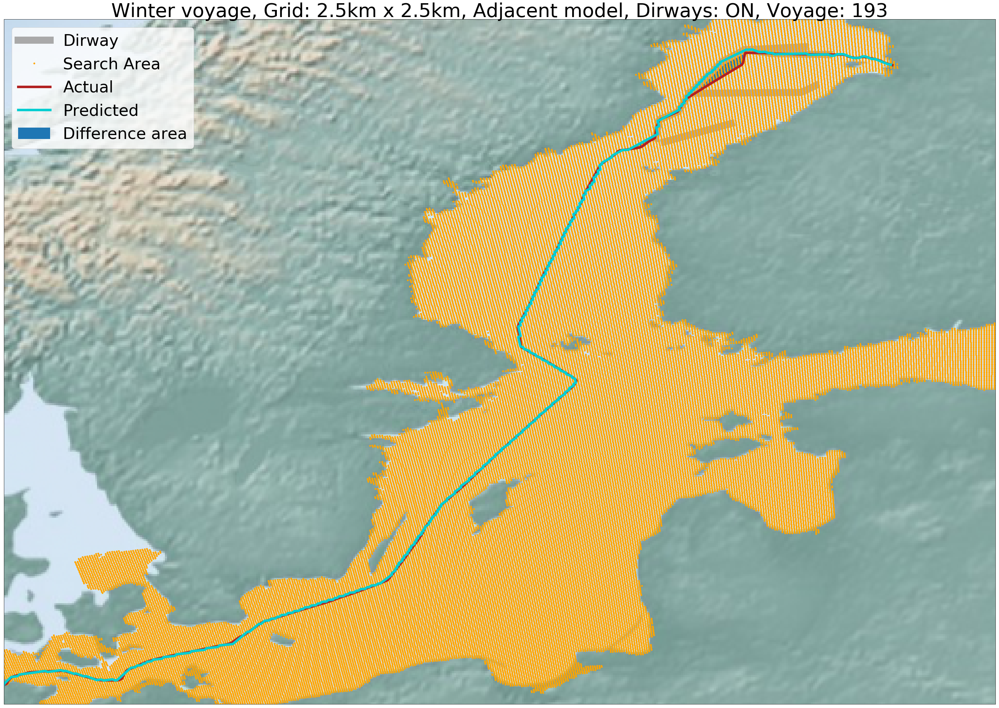

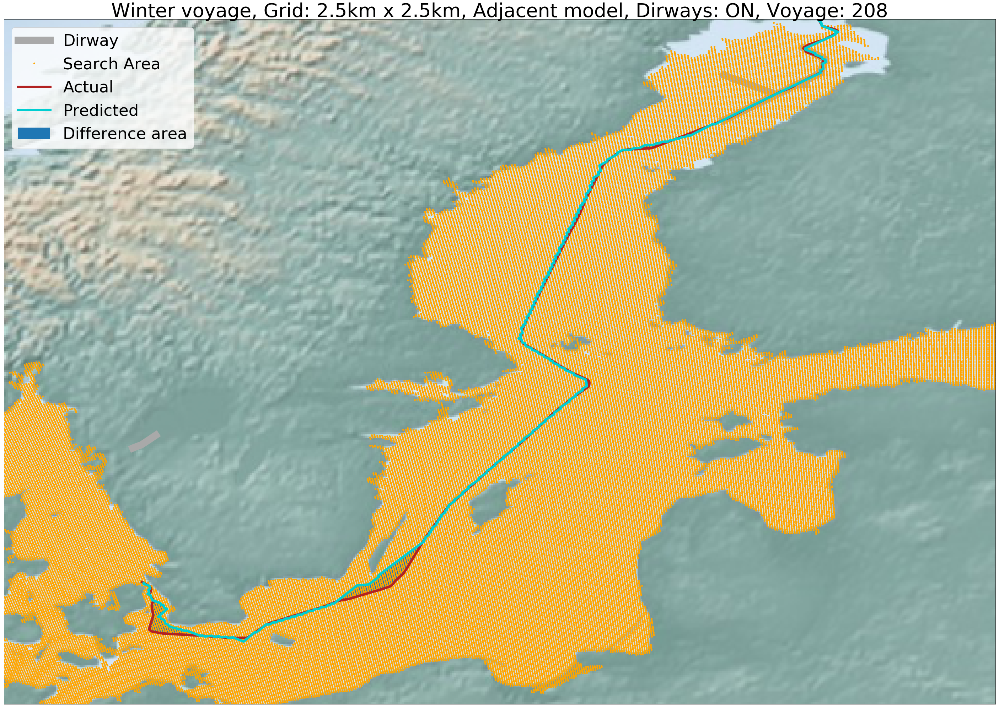

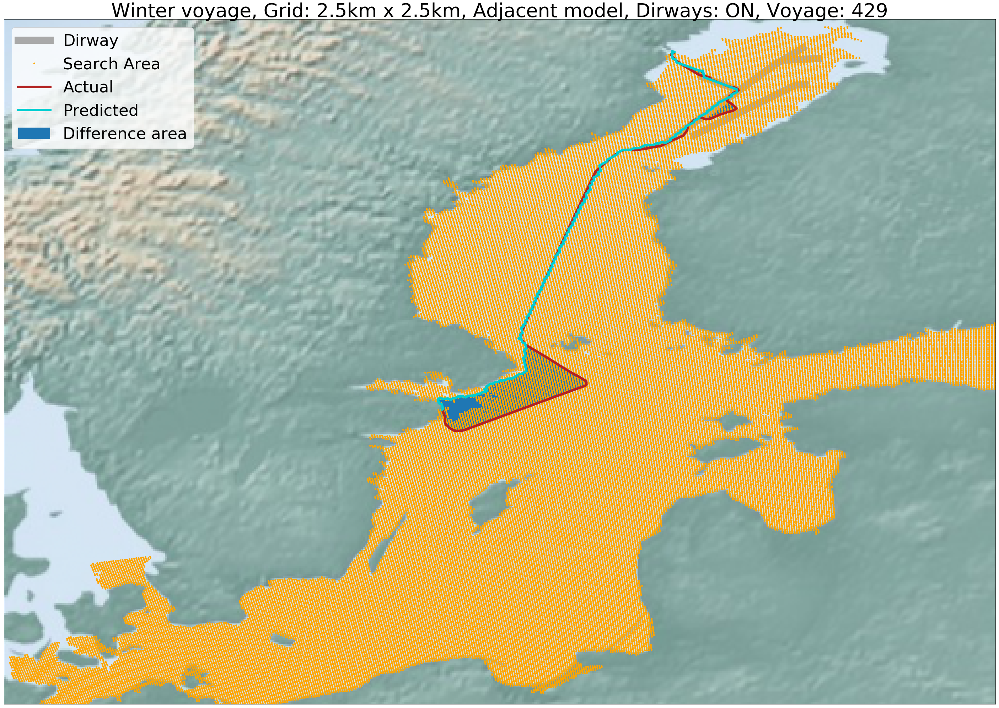

In [35]:
plot_route_and_search_area(routes_adjacent_2500m, areas_adjacent_2500m, test_voyages, dirways, 'Winter voyage, Grid: 2.5km x 2.5km, Adjacent model, Dirways: ON, Voyage: ', False)